In [1]:
import sys, os

PROJECT_ROOT = os.path.dirname(os.path.abspath("__file__"))  # notebook directory
A_DIR = os.path.join(PROJECT_ROOT, "anomaly_ov")

if A_DIR not in sys.path:
    sys.path.insert(0, A_DIR)

In [2]:
A_DIR

'/Users/francescobassignana/Desktop/school/unitn/adversarial_sensitivity_project/anomaly_ov'

In [3]:
dataset = {
    0: "./inpainting_dataset",  # parent folder expected to contain 'inpainted' and 'masks'
    1: "./data"        # parent folder; should have 'inpainted' and 'masks'
}

In [11]:
demonstrative = True
# Parameters for anomaly scoring visualization
model_checkpoint = "lmms-lab/llava-onevision-qwen2-0.5b-ov"  # or local path
size = "07b"  # or "7b"
images_dir = dataset[int(demonstrative)]  # this is now the PARENT folder
pattern = "*.*"  # glob pattern
max_side = 1024
show_n = 12  # number of images to visualize (sorting functionality retained)
sort_by_score = True  # if True, show top-N highest scores; else first N
images_dir

'./data'

In [12]:

from glob import glob
from PIL import Image
import os, torch
from anomaly_ov.llava.model.builder import load_pretrained_model
from anomaly_ov.llava.mm_utils import process_images
from anomaly_ov.llava.model.anomaly_expert import AnomalyOV
from anomaly_ov.utils_trends.vulnerability_map import predict_with_model, adversarial_recompute, visualize_anomaly_gradcam, compute_mask_anomaly_metrics

# Derive inpainted and masks subfolders from parent
inpainted_dir = os.path.join(images_dir, 'inpainted')
masks_dir = os.path.join(images_dir, 'masks')
if not os.path.isdir(inpainted_dir):
    raise SystemExit(f"Inpainted folder not found: {inpainted_dir}")
if not os.path.isdir(masks_dir):
    print(f"Warning: Masks folder not found: {masks_dir}. Mask visualization will be skipped.")

device = "cpu"
# Load model
model_name = "llava_qwen"
_, model, image_processor, _ = load_pretrained_model(
    model_checkpoint,
    None,
    model_name,
    device_map="auto",
    cache_dir="./cache",
    torch_dtype="bfloat16",
    overwrite_config=None,
    attn_implementation="sdpa",
    device=device

)

model.eval()


# Load anomaly encoder
if size != '7b':
    model.lm_head.weight = model.model.embed_tokens.weight
    anomaly_encoder_weight_path = './anomaly_ov/pretrained_expert_05b.pth'
else:
    anomaly_encoder_weight_path = './anomaly_ov/pretrained_expert_7b.pth'

anomaly_encoder = AnomalyOV()
anomaly_encoder.load_zero_shot_weights(path=anomaly_encoder_weight_path)
anomaly_encoder.freeze_layers()
anomaly_encoder.to(dtype=torch.float32, device=device)
anomaly_encoder.requires_grad_(False)
anomaly_encoder.eval()
model.set_anomaly_encoder(anomaly_encoder)

# Collect images ONLY from inpainted subfolder now
image_paths = sorted([
    p for p in glob(os.path.join(inpainted_dir, '**', pattern), recursive=True)
    if os.path.isfile(p)
])
print(f"Found {len(image_paths)} inpainted images in {inpainted_dir}")
if not image_paths:
    raise SystemExit("No inpainted images found. Adjust parent folder or pattern.")

Loaded LLaVA model: lmms-lab/llava-onevision-qwen2-0.5b-ov


You are using a model of type llava to instantiate a model of type llava_qwen. This is not supported for all configurations of models and can yield errors.


INIT EXECUTED
Loading vision tower: google/siglip-so400m-patch14-384
INIT EXECUTED
INIT EXECUTED


/Users/francescobassignana/miniforge3/envs/deepl/lib/python3.10/site-packages/torch/nn/modules/module.py:2446: UserWarning: for vision_model.embeddings.patch_embedding.weight: copying from a non-meta parameter in the checkpoint to a meta parameter in the current model, which is a no-op. (Did you mean to pass `assign=True` to assign items in the state dictionary to their corresponding key in the module instead of copying them in place?)
  warnings.warn(
/Users/francescobassignana/miniforge3/envs/deepl/lib/python3.10/site-packages/torch/nn/modules/module.py:2446: UserWarning: for vision_model.embeddings.patch_embedding.bias: copying from a non-meta parameter in the checkpoint to a meta parameter in the current model, which is a no-op. (Did you mean to pass `assign=True` to assign items in the state dictionary to their corresponding key in the module instead of copying them in place?)
  warnings.warn(
/Users/francescobassignana/miniforge3/envs/deepl/lib/python3.10/site-packages/torch/nn/m

Model Class: LlavaQwenForCausalLM
Matched names: ['positive_embedding', 'negative_embedding', 'pooling_layer.0.weight', 'pooling_layer.0.bias', 'class_predictor.0.weight', 'class_predictor.0.bias', 'class_predictor.2.weight', 'class_predictor.2.bias', 'siglip_adaptors.0.weight', 'siglip_adaptors.0.bias', 'siglip_adaptors.1.weight', 'siglip_adaptors.1.bias', 'siglip_adaptors.2.weight', 'siglip_adaptors.2.bias', 'siglip_adaptors.3.weight', 'siglip_adaptors.3.bias', 'prompt_adaptors.0.weight', 'prompt_adaptors.0.bias', 'prompt_adaptors.1.weight', 'prompt_adaptors.1.bias', 'prompt_adaptors.2.weight', 'prompt_adaptors.2.bias', 'prompt_adaptors.3.weight', 'prompt_adaptors.3.bias', 'final_predictor.0.weight', 'final_predictor.0.bias', 'final_predictor.2.weight', 'final_predictor.2.bias', 'q_former.query_proj.weight', 'q_former.query_proj.bias', 'q_former.key_proj.weight', 'q_former.key_proj.bias']
Loaded number of keys: 32
Found 20 inpainted images in ./data/inpainted


In [13]:
# Sampling removed: use ALL inpainted images
image_paths_subset = image_paths  # keep variable name for downstream compatibility
print(f"Using all {len(image_paths_subset)} images for scoring and mask visualization.")

# Optional: quick check of mask correspondence count
missing_masks = 0
for p in image_paths_subset:
    mp = os.path.join(masks_dir, os.path.basename(p))
    if not os.path.isfile(mp):
        missing_masks += 1
if missing_masks:
    print(f"Warning: {missing_masks} masks missing out of {len(image_paths_subset)} images.")

Using all 20 images for scoring and mask visualization.


In [14]:
def get_image(img_path:str, device, max_side=1024):
    img = Image.open(img_path).convert('RGB')
    # Load corresponding mask (single full-image mask)
    mask_path = os.path.join(masks_dir, os.path.basename(img_path))
    mask_img = Image.open(mask_path).convert('L') if os.path.isfile(mask_path) else None

    if max(img.size) > max_side:
        if img.width > img.height:
            new_w = max_side
            new_h = int(max_side * img.height / img.width)
        else:
            new_h = max_side
            new_w = int(max_side * img.width / img.height)
        img = img.resize((new_w, new_h))
    image_tensor = process_images([img], image_processor, model.config).to(device)
    mask_tensor = process_images([mask_img], image_processor, model.config).to(device)
    return image_tensor, mask_tensor


image_aspect_ratio: anyres_max_9
grid_pinpoints: 36
image_aspect_ratio: anyres_max_9
grid_pinpoints: 36
mask shape: torch.Size([1, 5, 3, 384, 384])
width: 384, height: 384, device: cpu
image_tensor DEVICE: cpu
with_attention_map: True
final_preds: tensor([[0.7227]], device='mps:0', dtype=torch.bfloat16) size_attn_maps: torch.Size([5, 729, 729]) size_anomaly_map: torch.Size([5, 1, 384, 384])
Processed image tensor shape: torch.Size([1, 5, 3, 384, 384])
image_tensor DEVICE: cpu
with_attention_map: True
final_preds: tensor([[0.6914]], device='mps:0', dtype=torch.bfloat16) size_attn_maps: torch.Size([5, 729, 729]) size_anomaly_map: torch.Size([5, 1, 384, 384])
Metrics for image 1: IoU@k=0.50: 0.39 | Mass: 0.55 | ROC: 0.68 | PR: 0.44 | SCORE: 0.72
image_aspect_ratio: anyres_max_9
grid_pinpoints: 36
image_aspect_ratio: anyres_max_9
grid_pinpoints: 36
mask shape: torch.Size([1, 5, 3, 384, 384])
width: 384, height: 384, device: cpu
image_tensor DEVICE: cpu
with_attention_map: True
final_preds:

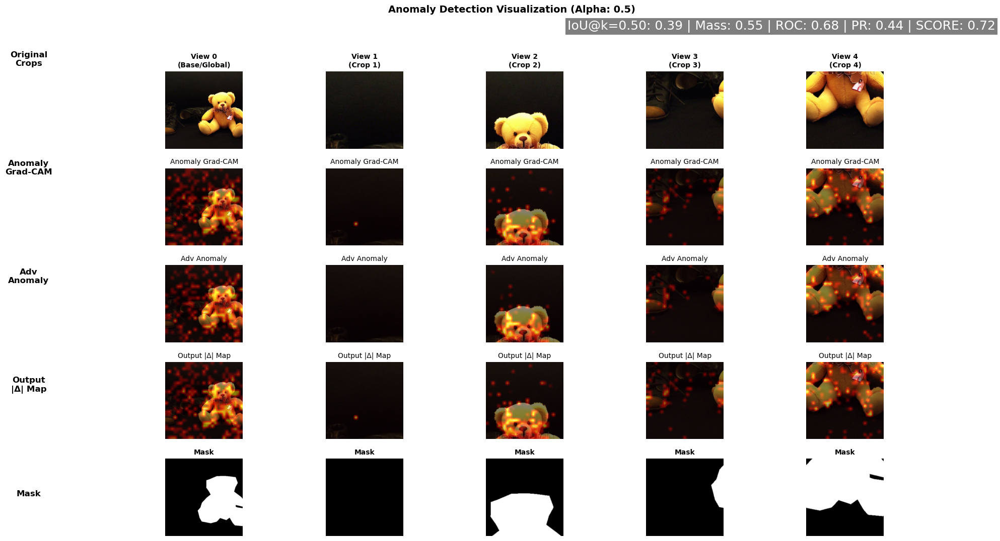

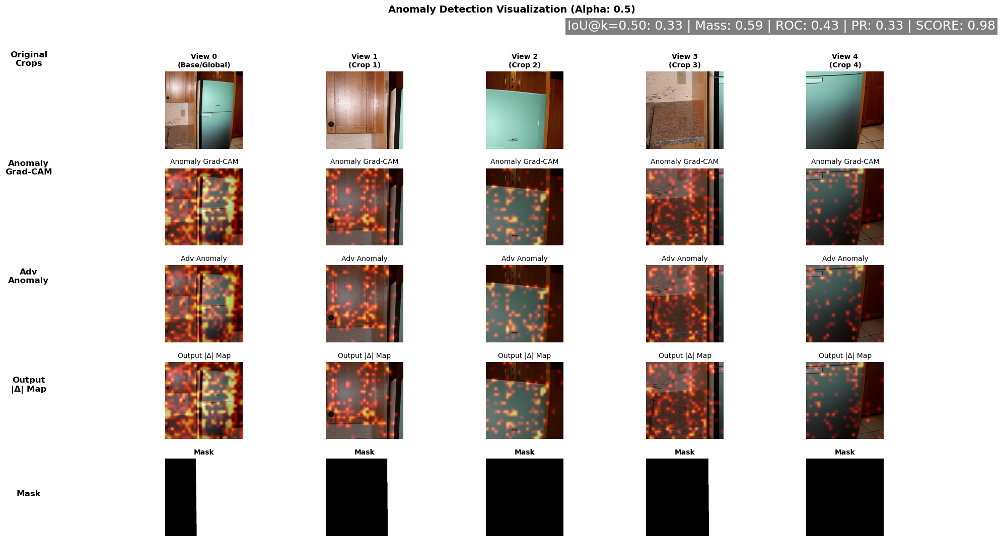

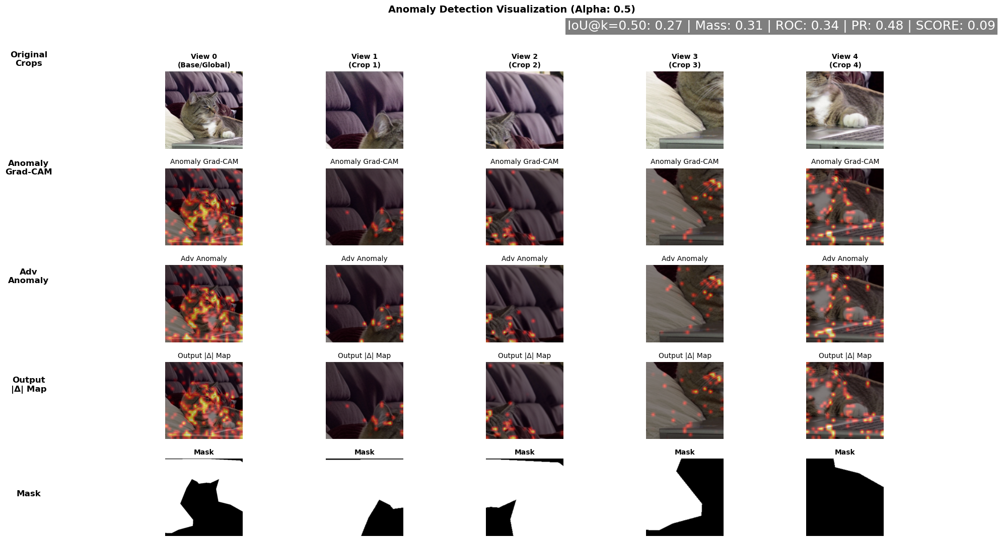

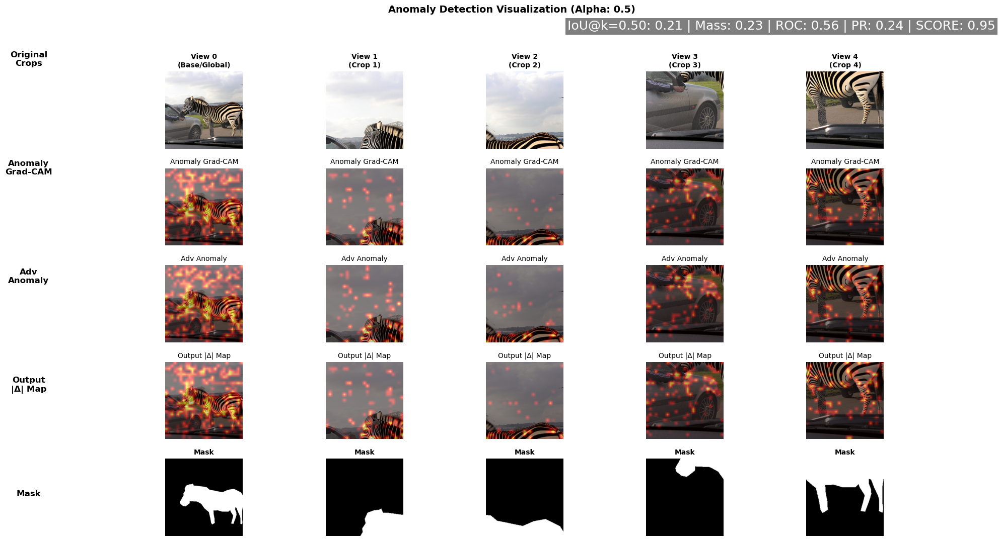

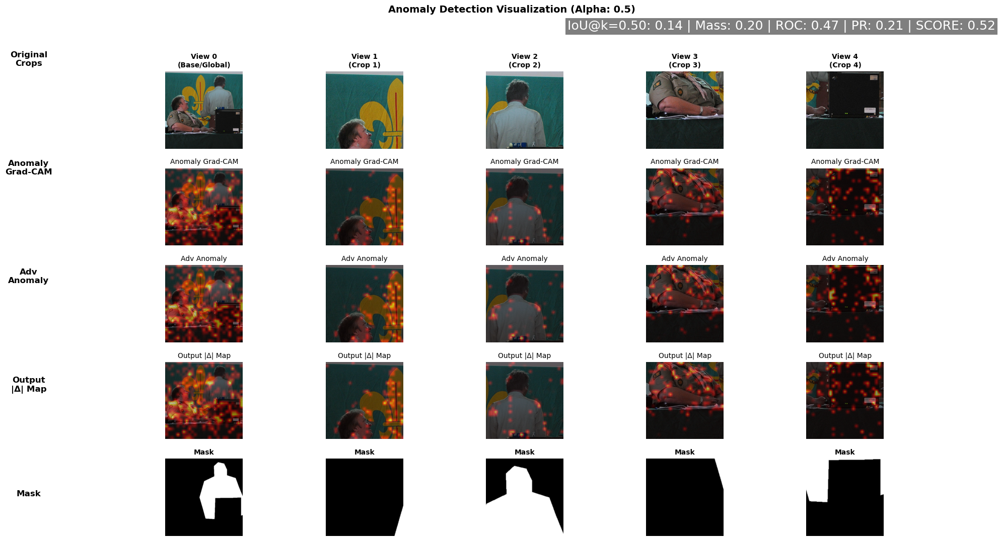

...

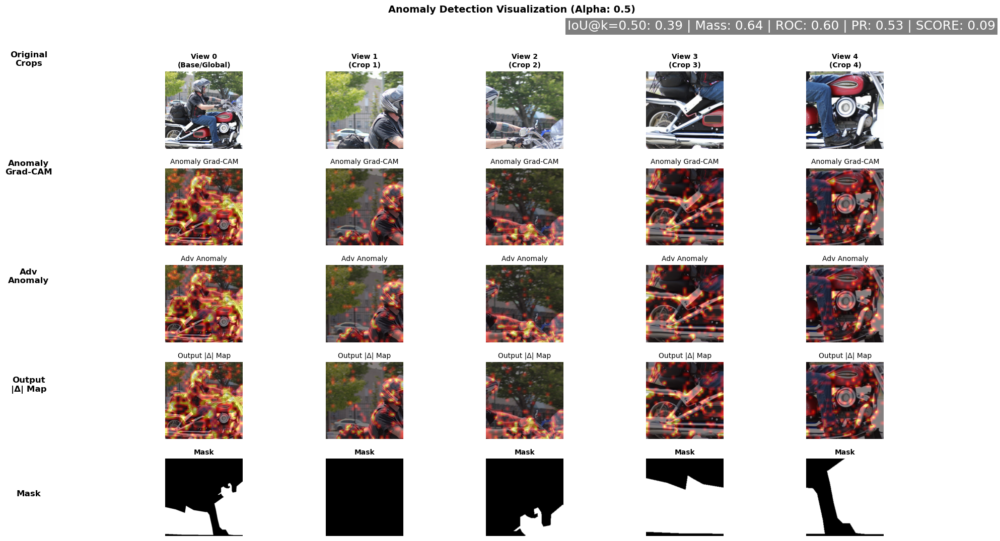

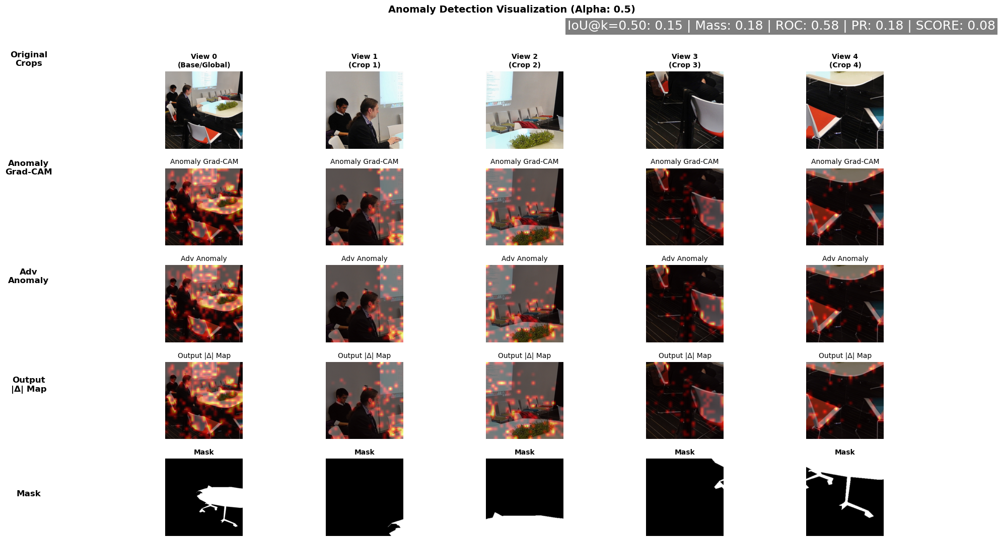

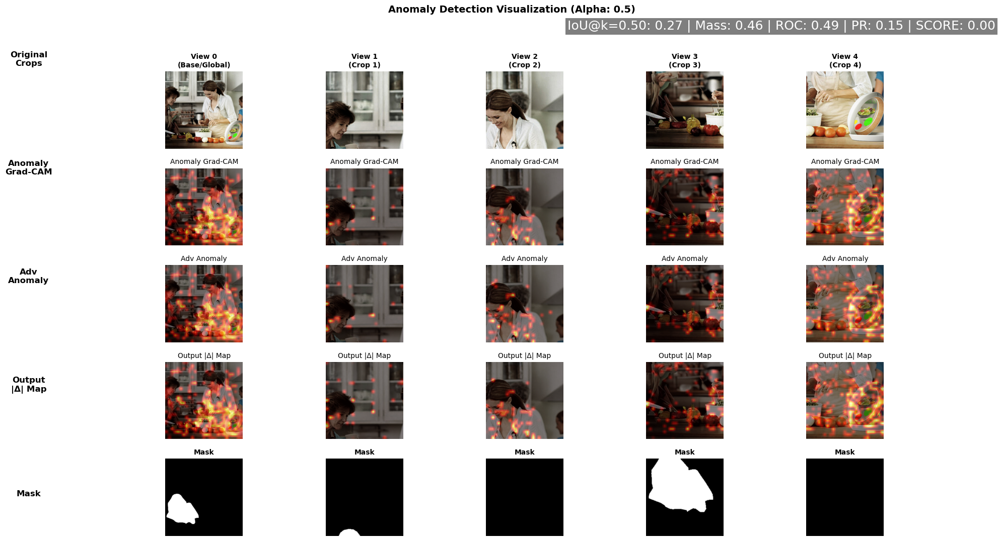

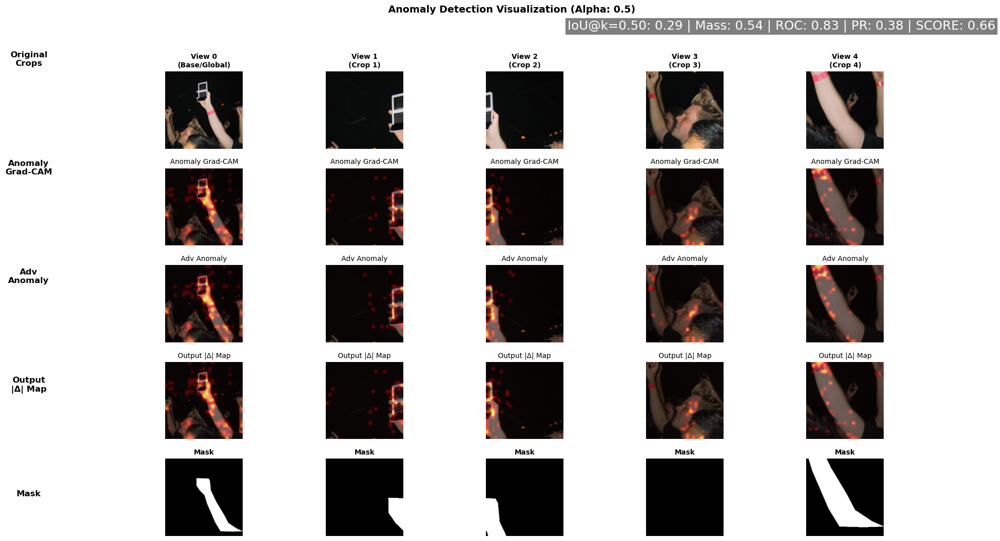

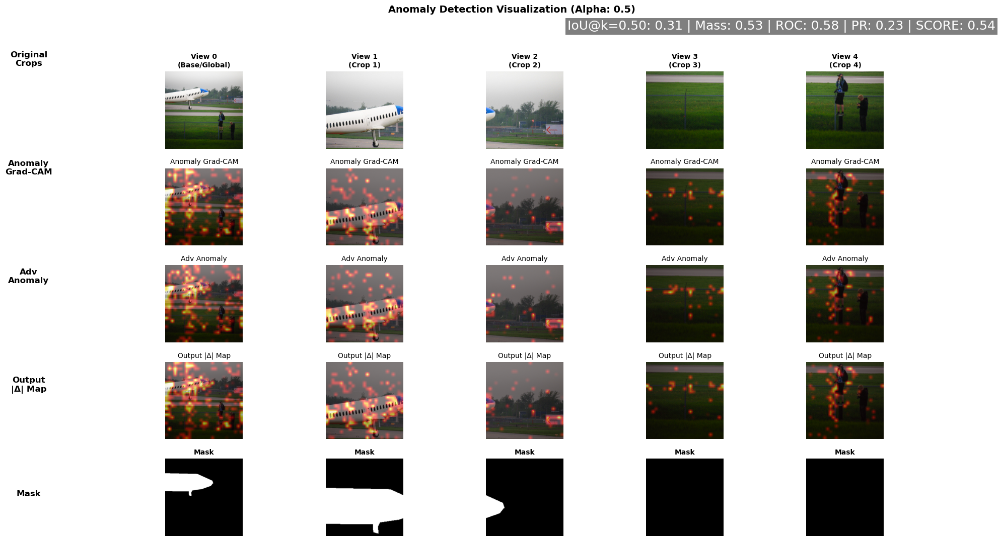

In [23]:
# Compute anomaly scores for ALL inpainted images now (sampling removed)
import numpy as np
scores = []
metrics_results = []  # store per-image metrics
break_at =20

# Metrics aggregator class
class MetricsAverages:
    def __init__(self):
        self.sums = {}
        self.counts = {}
    def update(self, metrics: dict):
        for k, v in metrics.items():
            if isinstance(v, (int, float)) and not np.isnan(v):
                self.sums[k] = self.sums.get(k, 0.0) + float(v)
                self.counts[k] = self.counts.get(k, 0) + 1
    def averages(self):
        return {k: (self.sums[k] / self.counts[k]) if self.counts.get(k,0) > 0 else float('nan') for k in self.sums}
    def __str__(self):
        avg = self.averages()
        return ", ".join(f"{k}={avg[k]:.4f}" if not np.isnan(avg[k]) else f"{k}=nan" for k in sorted(avg))

metrics_agg = MetricsAverages()

# Attack hyperparameters
attack_epsilon = 0.15  # norm bound
attack_top_k = 0.20    # fraction for M_topk
attack_noise_mode = 'structured'  # 'random' or 'structured'

for idx, img_path in enumerate(image_paths_subset, 1):
    image_tensor, mask_tensor = get_image(img_path, device)
    print(f"mask shape: {mask_tensor.shape}")
    W, H = image_tensor.shape[3:]

    print(f"width: {W}, height: {H}, device: {image_tensor.device}")
    with torch.no_grad():
        score, attn_maps, anomaly_maps, vuln_map, image_tensor = predict_with_model(
            model=model,
            image_tensor=image_tensor,
            device=device,
            max_side=1024,
            anomaly_map_size=(W,H),
        )
    print(f"Processed image tensor shape: {image_tensor.shape}")

    # Adversarial attack + recompute anomaly map
    attacked_image, anomaly_maps_adv, output_map = adversarial_recompute(
        model=model,
        image_tensor=image_tensor,
        original_anomaly_maps=anomaly_maps,
        device=device,
        epsilon=attack_epsilon,
        top_k=attack_top_k,
        noise_mode=attack_noise_mode,
    )

    # Compute correlation metrics between OUTPUT map and per-crop mask tensor
    metrics = compute_mask_anomaly_metrics(
        anomaly_maps=output_map,
        mask_image=mask_tensor,
        top_k=0.50,
        aggregate='mean',
        white_threshold=None,
        inpainted_is_white=True,
    )
    metrics_results.append((img_path, metrics))
    metrics_agg.update(metrics)

    # Prepare metrics label with two decimals
    def f2(x):
        return 'nan' if (x is None or (isinstance(x, float) and np.isnan(x))) else f"{float(x):.2f}"
    metrics_label = (
        f"IoU@k=0.50: {f2(metrics.get('iou_topk'))} | "
        f"Mass: {f2(metrics.get('mass_frac'))} | "
        f"ROC: {f2(metrics.get('roc_auc'))} | "
        f"PR: {f2(metrics.get('pr_auc'))} | "
        f"SCORE: {f2(score)}"
    )
    print(f"Metrics for image {idx}: {metrics_label}")

    # Updated visualization with Adv Anomaly and Output |Δ| Map (single metrics label)
    fig = visualize_anomaly_gradcam(
        image_tensor,
        anomaly_maps,
        vuln_maps=vuln_map if len(vuln_map) > 0 else None,
        mask_image=mask_tensor,
        anomaly_maps_adv=anomaly_maps_adv,
        output_maps=anomaly_maps,
        alpha=0.5,
        metrics_label=metrics_label,
    )
    if idx == break_at:
        break
    scores.append((img_path, score))
    if idx % 20 == 0:
        print(f"[{idx}] {img_path} -> {score:.6f}")

print(f"Scored {len(scores)} images")
scores_array = np.array([[s[0], s[1]] for s in scores], dtype=object)
print("Average metrics:", str(metrics_agg))

In [ ]:
# # Example usage:
# # Load a test image
# test_img_path = image_paths_subset[0] if image_paths_subset else image_paths[0]
# test_img = Image.open(test_img_path).convert('RGB')

# # Process the image
# image_tensor = process_images([test_img], image_processor, model.config)
# print(f"Image tensor shape: {image_tensor.shape}")

# # Get attention maps and anomaly maps from the model
# _, _, final_preds, attn_maps, anomaly_maps = model.get_anomaly_fetures_from_images(
#     image_tensor, 
#     with_attention_map=True,
#     anomaly_map_size=(350, 350)
# )

# print(f"Attention maps shape: {attn_maps.shape}")
# print(f"Anomaly maps shape: {anomaly_maps.shape}")

# # Visualize everything
# fig = visualize_attention_and_anomaly_maps(image_tensor, attn_maps, anomaly_maps)
# plt.show()